<a href="https://colab.research.google.com/github/ramannaik1408/GIS/blob/main/ps4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Research Interest**

I am intersted on working on data about population density and the income variance in that particulat area.
The region I have chosen is one of favourite in the US, that is, California. The reason I have chosen California is because of its size, diversity and complexity. Plus, there is a lot of data to work with for California.


### Resources

I have found a perfect shapefile for California already from the following resource:

https://hub.arcgis.com/datasets/a61c138d0a6946da8d1ebb8d1c9db13a_0/explore?location=17.138890%2C75.315503%2C2.87

I have also found data for the median income of California according to County:

https://data.ca.gov/dataset/income-limits-by-county

I have also found data for crime rate by county in California:

https://www.ppic.org/wp-content/uploads/crime-rates-by-county-2019.xlsx

I am working on data with respect to income and crime in California
I am going to compare these factors to find trends and relation between income and crimne in this state


I have uploaded the data that I have found in the GitHub repo

# **PS0**

In [113]:
import os, zipfile
import pandas as pd
import matplotlib.pyplot as plt

import geopandas as gpd


from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from google.colab import data_table
data_table.enable_dataframe_formatter()

In [114]:
import time, webbrowser, zipfile

import pandas as pd
import geopandas as gpd

from google.colab import data_table
data_table.enable_dataframe_formatter()

from geopandas.tools import geocode
#! pip install geocoder
from geopy.geocoders import Nominatim
#if you do a lot of geocoding:
#https://developers.google.com/maps/documentation/geocoding/overview

geolocator = Nominatim(user_agent='blah@gmail.com')

from google.colab import files

import folium as f
from folium.plugins import MarkerCluster, HeatMap

#will display all output not just last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [115]:
!pip install mapclassify
import mapclassify

In [116]:
! wget -q -O cali-counties.zip https://github.com/ramannaik1408/GIS/raw/main/California_County_Boundaries.zip
zip_ref = zipfile.ZipFile('cali-counties.zip', 'r'); zip_ref.extractall(); zip_ref.close()
cali=gpd.read_file('cnty19_1.shp') #load the shapefile of california

In [117]:
cali.dtypes

OBJECTID         int64
COUNTY_NAM      object
COUNTY_ABB      object
COUNTY_NUM       int64
COUNTY_COD      object
COUNTY_FIP      object
ISLAND          object
GlobalID        object
SHAPE_Leng     float64
SHAPE_Area     float64
geometry      geometry
dtype: object

In [118]:
cali_final= cali[['OBJECTID','COUNTY_NAM','SHAPE_Leng','SHAPE_Area','geometry']]


<Axes: >

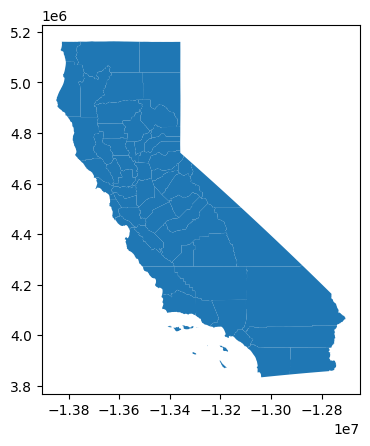

In [119]:
cali_final.plot()

# **PS1**

##Dataset Resources

I have found this dataset containing income of California residents by county from the following source:

https://data.ca.gov/dataset/income-limits-by-county

The AMI column contains the Annual Median Income in 2019 which I have made use of for plotting the map

In [120]:
income_cali = pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/2022-income-limits.csv')
income_cali

,County,AMI,ALI_1,ALI_2,ALI_3,ALI_4,ALI_5,ALI_6,ALI_7,ALI_8,...,LI_7,LI_8,MOD_1,MOD_2,MOD_3,MOD_4,MOD_5,MOD_6,MOD_7,MOD_8
0,Alameda,142800,15000,17100,19250,21400,23100,24800,26550,28250,...,135950,144700,119950,137100,154200,171350,185050,198750,212450,226200
1,Alpine,94900,10000,11400,12850,14250,15400,16550,17650,18800,...,90100,95900,79750,91100,102500,113900,123000,132100,141250,150350
2,Amador,86600,9100,10400,11700,13000,14050,15100,16100,17150,...,85950,91500,72750,83100,93500,103900,112200,120500,128850,137150
3,Butte,85000,8950,10200,11500,12750,13750,14800,15800,16850,...,77300,82250,71400,81600,91800,102000,110150,118300,126500,134650
4,Calaveras,90000,9450,10800,12150,13500,14600,15650,16750,17800,...,89300,95050,75600,86400,97200,108000,116650,125300,133900,142550
5,Colusa,80300,8450,9650,10850,12050,13000,14000,14950,15900,...,77300,82250,67450,77100,86700,96350,104050,111750,119450,127200
6,Contra Costa,142800,15000,17100,19250,21400,23100,24800,26550,28250,...,135950,144700,119950,137100,154200,171350,185050,198750,212450,226200
7,Del Norte,80300,8450,9650,10850,12050,13000,14000,14950,15900,...,77300,82250,67450,77100,86700,96350,104050,111750,119450,127200
8,El Dorado,102200,10750,12300,13800,15350,16600,17800,19050,20250,...,100550,107000,85850,98100,110400,122650,132450,142250,152100,161900
9,Fresno,80300,8450,9650,10850,12050,13000,14000,14950,15900,...,77300,82250,67450,77100,86700,96350,104050,111750,119450,127200


In [121]:
income_cali.rename(columns={'County': 'COUNTY_NAM','AMI': 'Annual Median Income'}, inplace=True)
##income_cali.rename(columns={'AMI': 'Annual Monthly Income'}, inplace=True)
income_cali=income_cali[['COUNTY_NAM','Annual Median Income']]
print(income_cali.columns)

Index(['COUNTY_NAM', 'Annual Median Income'], dtype='object')


##Plotting map containing income of California:

<Axes: >

[]

[]

Text(0.5, 240.73140612572422, 'source/definition: zillow.com/research/data')

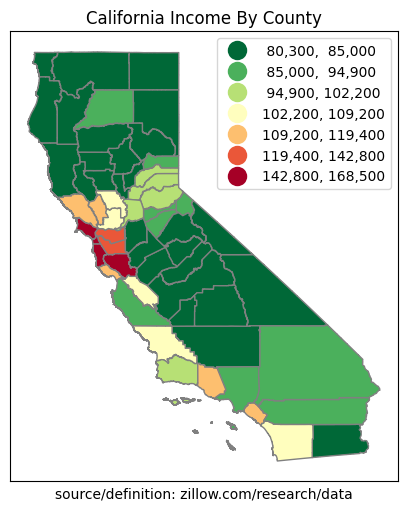

In [122]:
map1 = pd.merge(cali_final, income_cali, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(5,10))
map1.plot(ax=ax,column='Annual Median Income',legend=True,cmap='RdYlGn_r',
          scheme='natural_breaks',k=7, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg1 = ax.get_legend()
ax.title.set_text("California Income By County")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
ax.set_xlabel('''source/definition: zillow.com/research/data''')

:

##Dataset Resource

I have found this dataset containing crime data in California

https://www.ppic.org/wp-content/uploads/crime-rates-by-county-2019.xlsx

In [123]:
cali_crime=pd.read_excel('https://github.com/ramannaik1408/GIS/raw/main/crime-rates-by-county-2019.xlsx')
cali_crime

,County,Population,Violent,Murder,Rape,Robbery,Aggrevated assault,Property,Burglary,Vehicle theft,Larceny theft
0,Alameda,1664783.0,584.700829,5.766517,42.167658,295.293741,241.472913,4008.390283,391.402363,616.717014,3000.270906
1,Alpine,1149.0,1131.418625,0.000000,174.064404,0.000000,957.354221,2785.030461,1131.418625,348.128808,1305.483029
2,Amador,37820.0,290.851401,2.644104,21.152829,23.796933,243.257536,1771.549445,470.650449,97.831835,1203.067160
3,Butte,221521.0,462.258657,3.159971,81.256405,75.387886,302.454395,2402.481029,501.532586,391.836440,1509.112003
4,Calaveras,45085.0,321.614728,2.218033,75.413109,19.962293,224.021293,1858.711323,658.755684,153.044250,1046.911390
5,Colusa,21990.0,263.756253,0.000000,68.212824,40.927694,154.615734,1577.989995,495.679854,254.661210,827.648931
6,Contra Costa,1150621.0,359.631886,4.693118,27.811069,132.015668,195.112031,2481.703358,311.136334,399.697207,1770.869817
7,Del Norte,27127.0,401.813691,7.372728,47.922734,95.845468,250.672761,2963.836768,925.277399,173.259115,1865.300254
8,El Dorado,190018.0,169.983896,2.631330,31.049690,28.944626,107.358250,1346.714522,331.021272,76.834826,938.858424
9,Fresno,1015195.0,466.609863,5.417678,26.300366,90.425977,344.465842,2284.782726,462.374224,343.086796,1479.321707


##Rounding off to 2 decimal places to make it look neater

In [124]:
cali_crime.rename(columns={'County': 'COUNTY_NAM'}, inplace=True)
cali_crime=cali_crime.round(2)

##Plotting the map

So basically the above dataset contains crime data for Violent which is the sum of crimes of Murder, Rape, Robbery, Aggravated Assault per 100000 people. So I did not have to download the number by population since data was already processed

Hence, I have used the column Violent for plotting the map for Violent crimes.

<Axes: >

[]

[]

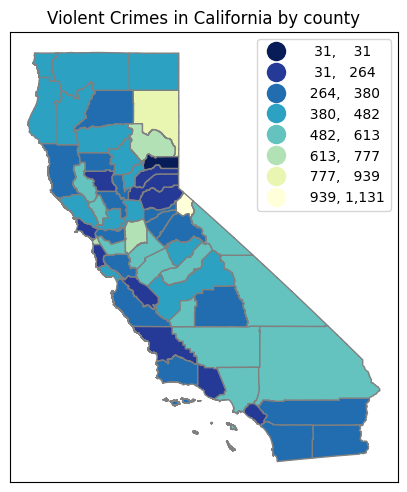

In [125]:
map2 = pd.merge(cali_final,cali_crime, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(5,10))
map2.plot(ax=ax,column='Violent',legend=True,cmap='YlGnBu_r',
          scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg1 = ax.get_legend()
ax.title.set_text("Violent Crimes in California by county")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks

aok: it is interesting that highest crime area is right next to the lowest

##Plotting the map

The above dataset also contains crime data for Property which is the sum of crimes of Burglary, Vehicle Theft and Larceny Theft per 100000 people. So I did not have to divide the number by population since data was already processed

Hence, I have used the column Property for plotting the map for Property crimes.

<Axes: >

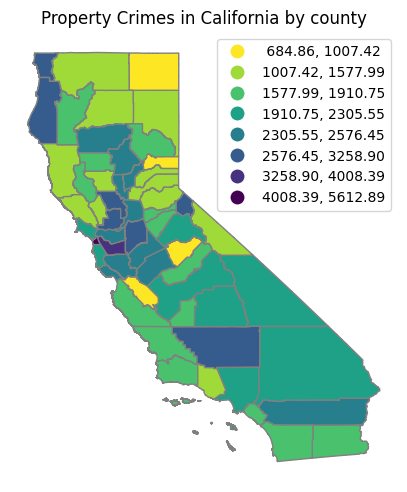

In [126]:
map3 = pd.merge(cali_final,cali_crime, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax) = plt.subplots(1,figsize=(5,10))
map3.plot(ax=ax,column='Property',cmap='viridis_r', scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,legend=True)
leg1 = ax.get_legend()
ax.set_axis_off()
ax.title.set_text("Property Crimes in California by county")
#ax.set_xticks([]) #kills xticks
#ax.set_yticks([]) #kills xticks
#ax.set_xlabel('''source/definition: zillow.com/research/data''')

##Side by side comparision of both the maps against Income

##Starting off with Property Crimes

<Axes: >

[]

[]

<Axes: >

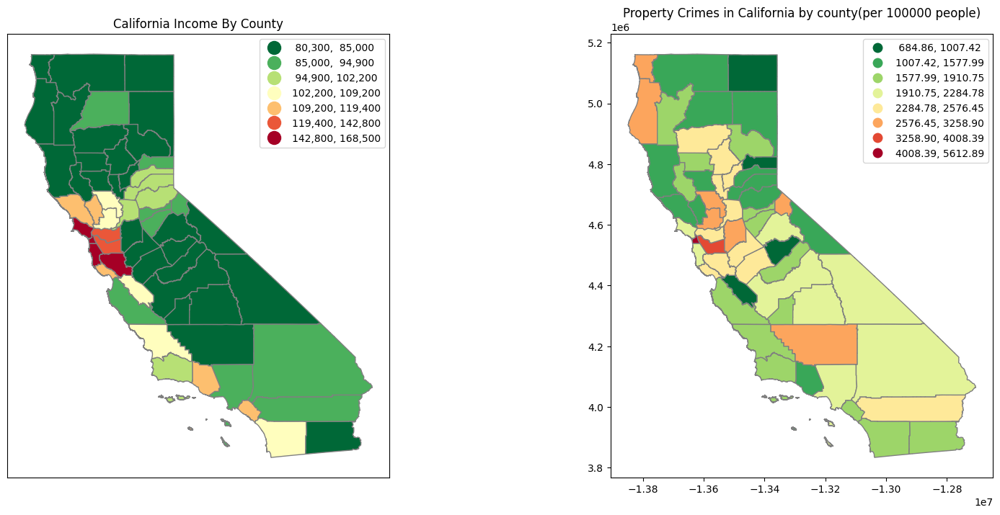

In [127]:
fig, (ax, ax2) = plt.subplots(1, 2, figsize=(18, 8), gridspec_kw={'wspace': 0.5})
map1 = pd.merge(cali_final, income_cali, on='COUNTY_NAM',how='outer',indicator=False)
#fig, ax = plt.subplots(1, figsize=(5,10))
map1.plot(ax=ax,column='Annual Median Income',legend=True,cmap='RdYlGn_r',
          scheme='natural_breaks',k=7, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg1 = ax.get_legend()
ax.title.set_text("California Income By County")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks

map3 = pd.merge(cali_final,cali_crime, on='COUNTY_NAM',how='outer',indicator=False)
#fig, ax2 = plt.subplots(1,figsize=(5,10))
map3.plot(ax=ax2,column='Property',cmap='RdYlGn_r', scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,legend=True)
leg1 = ax2.get_legend()
#ax2.set_axis_off()
ax2.title.set_text("Property Crimes in California by county(per 100000 people)")
#ax.set_xticks([]) #kills xticks
#ax.set_yticks([]) #kills xticks


From the above map we can conclude that property crimes are reasonably high in areas like San Francisco Bay area, Los Angeles and San Diego.

The reason for this can be inferred from the income map because the income is quite high in those counties, hence we can find richer people, hence more Property crime because of more money and high tech property.


There is an exception case in this map, that is, the north western side(Del Norte and Humboldt Region) of the sate, where income is low, but property crime is high. One of the reason could be that, they are tourist hotspots because they are filled with National Parks, hence a lot of visitors, so that might be affecting the crime rate there.

##Violent Crimes

<Axes: >

[]

[]

<Axes: >

[]

[]

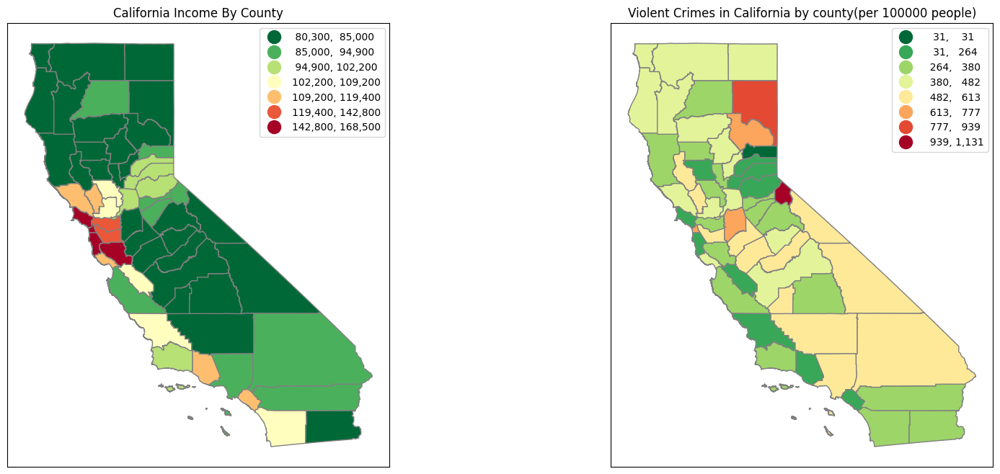

In [128]:
fig, (ax, ax2) = plt.subplots(1, 2, figsize=(18, 8), gridspec_kw={'wspace': 0.5})
map1 = pd.merge(cali, income_cali, on='COUNTY_NAM',how='outer',indicator=False)
#fig, ax = plt.subplots(1, figsize=(5,10))
map1.plot(ax=ax,column='Annual Median Income',legend=True,cmap='RdYlGn_r',
          scheme='natural_breaks',k=7, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg1 = ax.get_legend()
ax.title.set_text("California Income By County")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks

map2 = pd.merge(cali,cali_crime, on='COUNTY_NAM',how='outer',indicator=False)
#fig, ax = plt.subplots(1, figsize=(5,10))
map2.plot(ax=ax2,column='Violent',legend=True,cmap='RdYlGn_r',
          scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg1 = ax.get_legend()
ax2.title.set_text("Violent Crimes in California by county(per 100000 people)")
ax2.set_xticks([]) #kills xticks
ax2.set_yticks([]) #kills xticks

From the violent crime we can conclude that the richer areas like Los Angeles, San Francisco, San Diego have relatively lesser crime per 100000 people. This is reasonable because we can see that these counties have high population, hence, predators are in fear of commiting these crimes.

Towards the northeast side of California that is less populated has higher crime rate. One of the reasons could be less population. Since it is not a very happening place and income is lesser, it is more suseptible to crime.

# **PS2**

Previously I had worked on relation between crime and income. Now I have extended that research towords literacy.

I want to see how literacy rate affects crime.

### Literacy Rate data resource

I have found a dataset for literacy rate in California by county from the following source:

https://nces.ed.gov/naal/estimates/stateestimates.aspx

In [129]:
#reading the CSV file
cali_literacy=pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/California%20Literacy%20Data.csv')
cali_literacy = cali_literacy.drop(cali_literacy.index[-5:], axis=0)
cali_literacy

,Location,FIPS code,Population size,Percent lacking basic prose literacy skills,Lower bound,Upper bound
0,California,6000.0,"26,029,840",23.0,20.3,26.2
1,Alameda County,6001.0,"1,100,269",19.0,11.9,28.3
2,Alpine County,6003.0,983,8.0,3.8,15.2
3,Amador County,6005.0,"27,145",10.0,4.7,17.2
4,Butte County,6007.0,"162,597",11.0,5.3,19.8
5,Calaveras County,6009.0,"36,110",9.0,4.2,15.5
6,Colusa County,6011.0,"14,057",34.0,19.5,50.7
7,Contra Costa County,6013.0,"751,262",12.0,7.1,20.3
8,Del Norte County,6015.0,"19,085",15.0,7.2,25.2
9,El Dorado County,6017.0,"131,630",7.0,3.4,13.1


**Renaming the column**

In [130]:
cali_literacy.rename(columns={'Location':'COUNTY_NAM'}, inplace=True)
cali_literacy

,COUNTY_NAM,FIPS code,Population size,Percent lacking basic prose literacy skills,Lower bound,Upper bound
0,California,6000.0,"26,029,840",23.0,20.3,26.2
1,Alameda County,6001.0,"1,100,269",19.0,11.9,28.3
2,Alpine County,6003.0,983,8.0,3.8,15.2
3,Amador County,6005.0,"27,145",10.0,4.7,17.2
4,Butte County,6007.0,"162,597",11.0,5.3,19.8
5,Calaveras County,6009.0,"36,110",9.0,4.2,15.5
6,Colusa County,6011.0,"14,057",34.0,19.5,50.7
7,Contra Costa County,6013.0,"751,262",12.0,7.1,20.3
8,Del Norte County,6015.0,"19,085",15.0,7.2,25.2
9,El Dorado County,6017.0,"131,630",7.0,3.4,13.1


In [131]:
cali_literacy['COUNTY_NAM']=cali_literacy['COUNTY_NAM'].str.replace(' County','') #get rid of ' County' [note space in front of county]
cali_literacy

,COUNTY_NAM,FIPS code,Population size,Percent lacking basic prose literacy skills,Lower bound,Upper bound
0,California,6000.0,"26,029,840",23.0,20.3,26.2
1,Alameda,6001.0,"1,100,269",19.0,11.9,28.3
2,Alpine,6003.0,983,8.0,3.8,15.2
3,Amador,6005.0,"27,145",10.0,4.7,17.2
4,Butte,6007.0,"162,597",11.0,5.3,19.8
5,Calaveras,6009.0,"36,110",9.0,4.2,15.5
6,Colusa,6011.0,"14,057",34.0,19.5,50.7
7,Contra Costa,6013.0,"751,262",12.0,7.1,20.3
8,Del Norte,6015.0,"19,085",15.0,7.2,25.2
9,El Dorado,6017.0,"131,630",7.0,3.4,13.1


### Plotting map with illiteracy data

<Axes: >

[]

[]

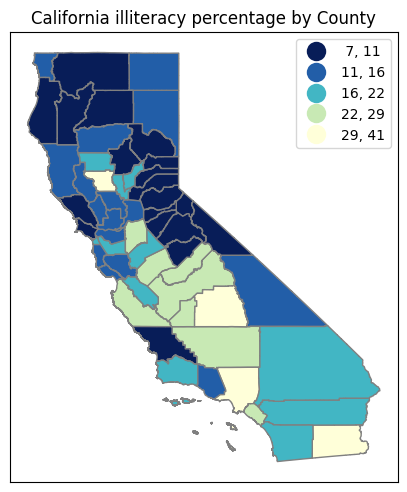

In [132]:
map4= pd.merge(cali_final, cali_literacy, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(5,10))
map4.plot(ax=ax,column="Percent lacking basic prose literacy skills",legend=True,cmap='YlGnBu_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg4 = ax.get_legend()
ax.title.set_text("California illiteracy percentage by County")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks



### Comparing illiteracy and crime

In [133]:
cali_scatter = map2.copy()
cali_scatter["geometry"] = cali_scatter["geometry"].centroid

<Axes: >

[]

[]

<Axes: title={'center': 'California illiteracy By County and \n Property Crime(per 100000 people)'}>

<Axes: >

[]

[]

<Axes: title={'center': 'California illiteracy By County and \n Violent Crime(per 100000 people)'}>

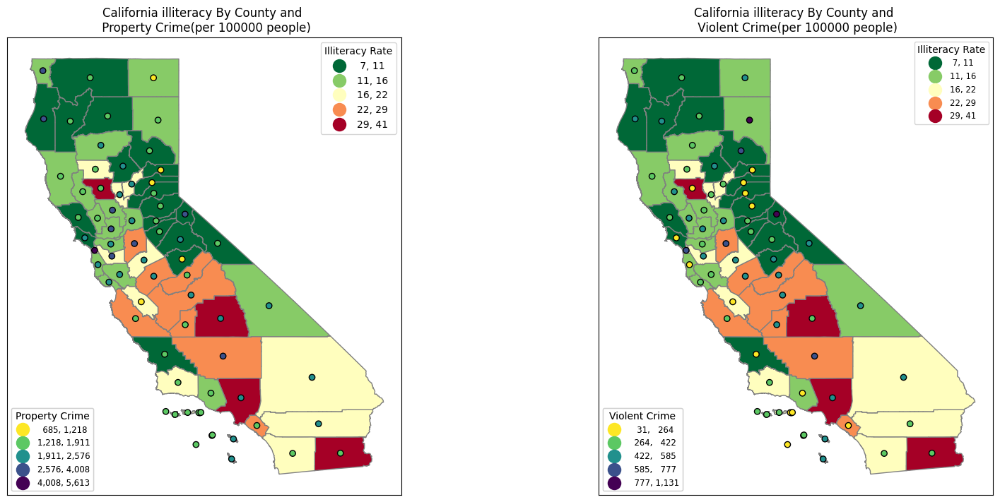

In [134]:
map4= pd.merge(cali_final, cali_literacy, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax, ax2) = plt.subplots(1, 2, figsize=(18,18), gridspec_kw={'wspace': 0.5})
map4.plot(ax=ax,column="Percent lacking basic prose literacy skills",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Illiteracy Rate''')

ax.title.set_text("California illiteracy By County and \n Property Crime(per 100000 people)")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
cali_scatter.plot(ax=ax,column='Property',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Property Crime''')

ax.add_artist(l2)
ax.add_artist(l1)

map5= pd.merge(cali_final, cali_literacy, on='COUNTY_NAM',how='outer',indicator=False)

map5.plot(ax=ax2,column="Percent lacking basic prose literacy skills",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','title_fontsize':'medium','fontsize':'small','markerscale':1.4},markersize = 100)
l3 = ax2.get_legend()
l3.set_title('''Illiteracy Rate''')


ax2.title.set_text("California illiteracy By County and \n Violent Crime(per 100000 people)")
ax2.set_xticks([]) #kills xticks
ax2.set_yticks([]) #kills xticks
cali_scatter.plot(ax=ax2,column='Violent',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l4 = ax2.get_legend()
l4.set_title('''Violent Crime''')

ax2.add_artist(l3)
ax2.add_artist(l4)

From the above graphs, surprisingly, we can see that illerate percent is relatively high in the surroundings of Los Angeles and San Diego. In these counties the crime is somewhat high, too.

And also, again surprisngly, violent crimes and especially property crimes seem to be higher in area with low illiteracy rate. This comes as a shock, but this could be due to the fact that these counties are far from cities which leads to lesser job opportunities.

### Ideal place to live

For anyone planning to buy their dream house, they would prefer buying a house at a location where there is less crime, a place where they can earn good money and, of course, a place where the house is affordable.

So I am going add another variable and compare all these variables, so that we can find an ideal place to live in the state of California.

### Housing data resource

I have found the ideal data for Average house price in California by county from the following source:

https://www.zillow.com/research/data/

In [135]:
housing_price=pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/County_zhvi_uc_sfrcondo_tier_0.33_0.67_sm_sa_month.csv')
housing_price

,RegionID,SizeRank,RegionName,RegionType,StateName,State,Metro,StateCodeFIPS,MunicipalCodeFIPS,2000-01-31,...,2022-12-31,2023-01-31,2023-02-28,2023-03-31,2023-04-30,2023-05-31,2023-06-30,2023-07-31,2023-08-31,2023-09-30
0,3101,0,Los Angeles County,county,CA,CA,"Los Angeles-Long Beach-Anaheim, CA",6,37,208172.788596,...,829502.810854,821242.741172,809771.934361,798850.697690,794995.450197,797207.594955,803503.732566,813903.557266,826811.908041,839780.328951
1,139,1,Cook County,county,IL,IL,"Chicago-Naperville-Elgin, IL-IN-WI",17,31,146385.155298,...,280494.664766,279775.162247,279405.017697,279727.799914,281175.034995,282702.836685,284417.957941,286321.765242,288618.967790,290539.190184
2,1090,2,Harris County,county,TX,TX,"Houston-The Woodlands-Sugar Land, TX",48,201,109047.176651,...,282122.217000,280561.789892,278962.267728,277810.413585,277241.447932,277264.124421,277922.424892,278705.849581,279517.195775,279853.296741
3,2402,3,Maricopa County,county,AZ,AZ,"Phoenix-Mesa-Chandler, AZ",4,13,144001.236955,...,469794.199802,461785.739170,455694.900206,452409.120809,451379.630780,452147.348464,454099.982215,456847.226011,459823.101562,462334.960502
4,2841,4,San Diego County,county,CA,CA,"San Diego-Chula Vista-Carlsbad, CA",6,73,217703.083159,...,856569.796522,849344.740159,844153.147158,842332.828485,845497.899143,852278.907339,861774.630570,873182.847040,885118.607013,896653.069164
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3069,846,3206,Banner County,county,NE,NE,"Scottsbluff, NE",31,7,NaN,...,309607.876790,302173.541898,294956.505840,290882.066415,293584.363109,298157.986272,302772.781170,307977.389681,313113.572008,317389.495922
3070,1648,3207,Daggett County,county,UT,UT,NaN,49,9,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,318274.936585
3071,1432,3208,Thomas County,county,NE,NE,NaN,31,171,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,139373.434343
3072,2794,3212,McPherson County,county,NE,NE,"North Platte, NE",31,117,NaN,...,264030.696683,256663.947563,248667.657916,243333.005667,244843.114807,249018.002984,253154.272982,257516.145402,261854.018970,265660.729309


###Cleaning up the data

In [136]:
housing_price = housing_price[['RegionName','RegionType','State','2022-12-31']]
housing_price = housing_price.loc[housing_price['State']=='CA']
housing_price.rename(columns={'RegionName':'COUNTY_NAM'}, inplace=True)
housing_price['COUNTY_NAM']=housing_price['COUNTY_NAM'].str.replace(' County','')
housing_price

,COUNTY_NAM,RegionType,State,2022-12-31
0,Los Angeles,county,CA,8.295028e+05
4,San Diego,county,CA,8.565698e+05
5,Orange,county,CA,1.006981e+06
9,Riverside,county,CA,5.790747e+05
13,San Bernardino,county,CA,5.179181e+05
16,Santa Clara,county,CA,1.460325e+06
19,Alameda,county,CA,1.072412e+06
23,Sacramento,county,CA,5.204879e+05
37,Contra Costa,county,CA,8.059103e+05
46,Fresno,county,CA,3.781982e+05


### Plotting housing price map

<Axes: >

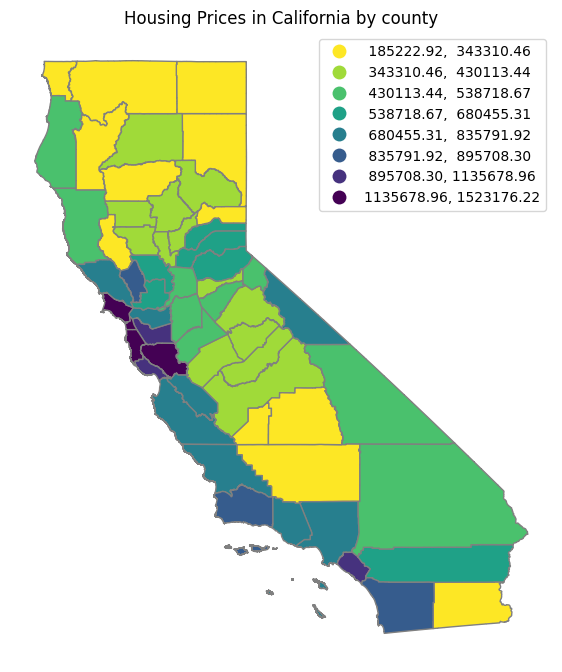

In [137]:
map6 = pd.merge(cali_final,housing_price, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax) = plt.subplots(1,figsize=(7,10))
map6.plot(ax=ax,column='2022-12-31',cmap='viridis_r', scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,legend=True)
leg1 = ax.get_legend()
ax.set_axis_off()
ax.title.set_text("Housing Prices in California by county")

### Comparing Housing Prices with Violent Crime and Income

In [138]:
map8=map1.copy()
map8["geometry"] = map8["geometry"].centroid

<Axes: >

[]

[]

<Axes: title={'center': 'California Housing Price By County and \n Violent Crime(per 100000 people)'}>

<Axes: >

<Axes: title={'center': 'California Housing Price By County and \n Annual Median Income'}>

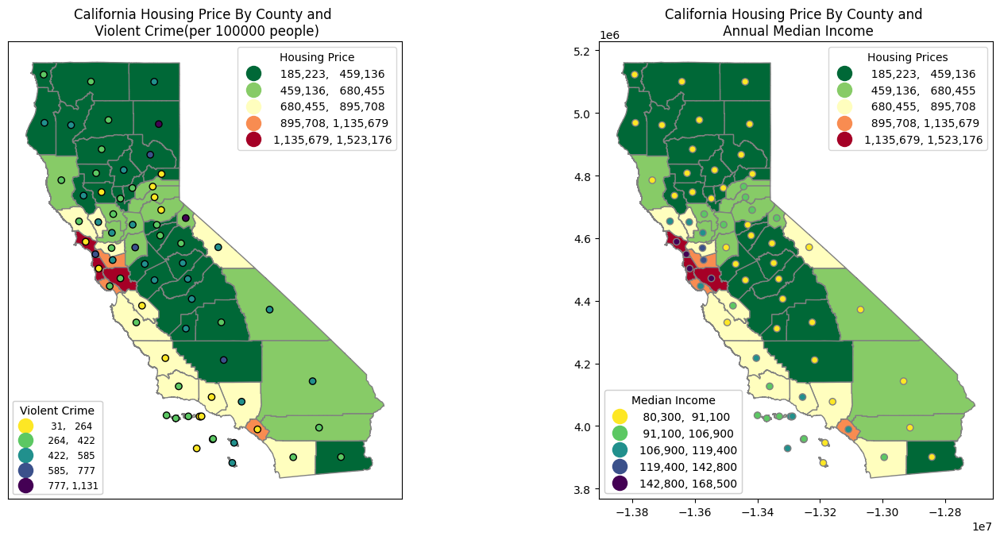

In [139]:
map7= pd.merge(cali_final, housing_price, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax, ax2) = plt.subplots(1, 2, figsize=(16,16), gridspec_kw={'wspace': 0.5})
map7.plot(ax=ax,column="2022-12-31",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Housing Price''')

ax.title.set_text("California Housing Price By County and \n Violent Crime(per 100000 people)")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
cali_scatter.plot(ax=ax,column='Violent',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Violent Crime''')

ax.add_artist(l2)
ax.add_artist(l1)

map7.plot(ax=ax2,column="2022-12-31",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l3 = ax2.get_legend()
l3.set_title('''Housing Prices''')
ax2.title.set_text("California Housing Price By County and \n Annual Median Income")
map8.plot(ax=ax2,column="Annual Median Income",legend=True,cmap='viridis_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'lower left','markerscale':1.4})

l4 = ax2.get_legend()
l4.set_title('''Median Income''')

ax2.add_artist(l3)
ax2.add_artist(l4)

### Compring Housing Prices with Property Crime and Income

<Axes: >

[]

[]

<Axes: title={'center': 'California Housing Price By County and \n Property Crime(per 100000 people)'}>

<Axes: >

<Axes: title={'center': 'California Housing Price By County and \n Annual Median Income'}>

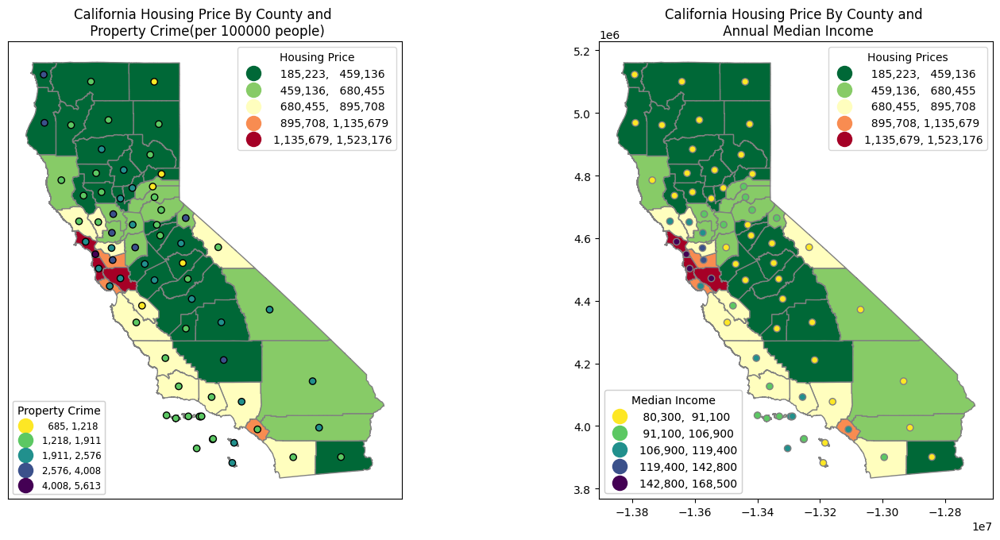

In [140]:
map7= pd.merge(cali_final, housing_price, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax, ax2) = plt.subplots(1, 2, figsize=(16,16), gridspec_kw={'wspace': 0.5})
map7.plot(ax=ax,column="2022-12-31",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Housing Price''')

ax.title.set_text("California Housing Price By County and \n Property Crime(per 100000 people)")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
cali_scatter.plot(ax=ax,column='Property',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Property Crime''')

ax.add_artist(l2)
ax.add_artist(l1)

map7.plot(ax=ax2,column="2022-12-31",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l3 = ax2.get_legend()
l3.set_title('''Housing Prices''')
ax2.title.set_text("California Housing Price By County and \n Annual Median Income")
map8.plot(ax=ax2,column="Annual Median Income",legend=True,cmap='viridis_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'lower left','markerscale':1.4})

l4 = ax2.get_legend()
l4.set_title('''Median Income''')

ax2.add_artist(l3)
ax2.add_artist(l4)

By comparing the above maps we can see that selective counties around cities like San Diego, Los Angeles and san Francisco seem to be ideal to settle down.

They have a perfect balance of low crime, good income, and not really expensive houses.

Therefore in a expensive state like California, these places can you some bucks and give you almost everyb other facility needed.

### Highlighting the area of interest

<Axes: >

<Axes: >

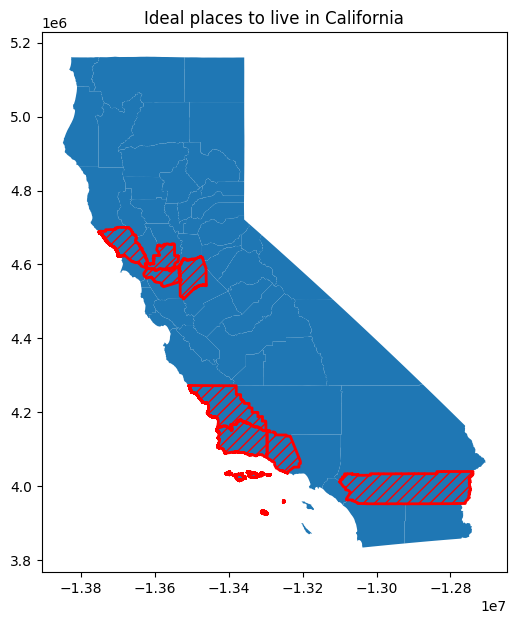

In [141]:
cali_highlight=cali_final.query("COUNTY_NAM=='Ventura' | COUNTY_NAM=='Santa Barbara' | COUNTY_NAM=='San Bernito' | COUNTY_NAM=='San Joaquin' | COUNTY_NAM=='Contra Costa' | COUNTY_NAM=='Solano' | COUNTY_NAM=='Sonoma' | COUNTY_NAM=='San Luis Obispo' | COUNTY_NAM=='Riverside'")
fig, ax = plt.subplots(1, figsize=(6,10))
cali_final.plot(ax=ax)
cali_highlight.plot(ax=ax,edgecolor='red',linewidth=2, facecolor="none",alpha=1,hatch='///')
ax.title.set_text("Ideal places to live in California")

Folks who are looking to buy a house in Cali, consider these highlighted places ;)

# **PS3**

In PS2, I had worked on factors like crime, income and housing prices to determine the ideal place to live in California

In PS3, I am going to extend this study to weather, access to public transport,and access to top universities in close proximity to the county

From this we can see if the ideal places we selected earlier, remain ideal or not for the new set of features

###Weather data source:

https://www.ncei.noaa.gov/access/monitoring/climate-at-a-glance/county/mapping/4/tavg/201906/1/value

###Plotting the weather of California by county:

In [142]:
cali_weather = pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/California_weather.csv')
cali_weather.rename(columns={'Name':'COUNTY_NAM'}, inplace=True)
cali_weather

,ID,COUNTY_NAM,State,Value,Rank,Anomaly (1901-2000 base period),1901-2000 Mean
0,CA-001,Alameda County,California,46.2,7,-3.3,49.5
1,CA-003,Alpine County,California,24.8,5,-5.5,30.3
2,CA-005,Amador County,California,38.9,1,-6.8,45.7
3,CA-007,Butte County,California,42.5,7,-4.4,46.9
4,CA-009,Calaveras County,California,40.2,3,-5.7,45.9
5,CA-011,Colusa County,California,44.4,4,-4.2,48.6
6,CA-013,Contra Costa County,California,46.4,6,-3.6,50.0
7,CA-015,Del Norte County,California,35.3,1,-6.2,41.5
8,CA-017,El Dorado County,California,34.5,2,-6.8,41.3
9,CA-019,Fresno County,California,38.2,9,-4.1,42.3


In [143]:
cali_weather['COUNTY_NAM']=cali_weather['COUNTY_NAM'].str.replace(' County','') #get rid of ' County' [note space in front of county]
cali_weather

,ID,COUNTY_NAM,State,Value,Rank,Anomaly (1901-2000 base period),1901-2000 Mean
0,CA-001,Alameda,California,46.2,7,-3.3,49.5
1,CA-003,Alpine,California,24.8,5,-5.5,30.3
2,CA-005,Amador,California,38.9,1,-6.8,45.7
3,CA-007,Butte,California,42.5,7,-4.4,46.9
4,CA-009,Calaveras,California,40.2,3,-5.7,45.9
5,CA-011,Colusa,California,44.4,4,-4.2,48.6
6,CA-013,Contra Costa,California,46.4,6,-3.6,50.0
7,CA-015,Del Norte,California,35.3,1,-6.2,41.5
8,CA-017,El Dorado,California,34.5,2,-6.8,41.3
9,CA-019,Fresno,California,38.2,9,-4.1,42.3


<Axes: >

<Axes: title={'center': 'Average Temprature in California by county'}>

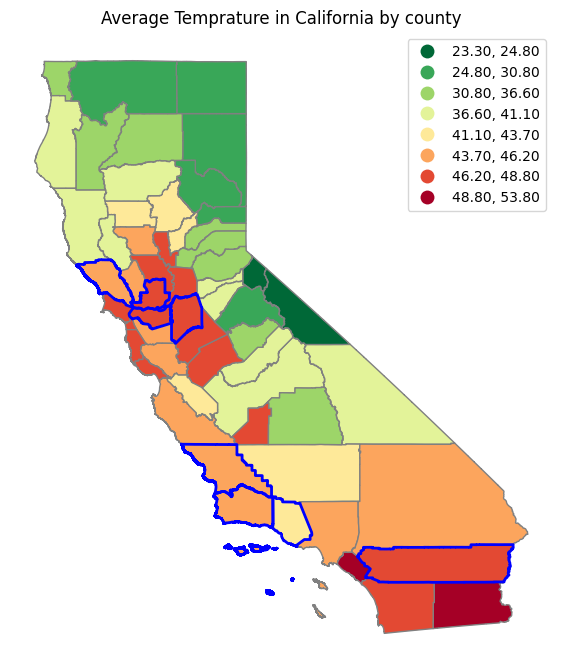

In [144]:
map7 = pd.merge(cali,cali_weather, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax) = plt.subplots(1,figsize=(7,10))
map7.plot(ax=ax,column='Value',cmap='RdYlGn_r', scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,legend=True)
leg1 = ax.get_legend()
ax.set_axis_off()
ax.title.set_text("Average Temprature in California by county")

cali_highlight.plot(ax=ax,edgecolor='blue',linewidth=2, facecolor="none",alpha=1)

###Rail network and bus stops data source

Rail network shapefile: https://data.ca.gov/dataset/california-rail-network

Bus stops shapefile: https://mygeodata.cloud/data/download/osm/bus-stops-and-stations/united-states-of-america--california

### Plotting the rail network and bus stops in California

In [145]:
! wget -q -O cali-counties.zip https://github.com/ramannaik1408/GIS/raw/main/California_Rail_Network.zip
zip_ref = zipfile.ZipFile('cali-counties.zip', 'r'); zip_ref.extractall(); zip_ref.close()
cali_rail=gpd.read_file('RR_California_Rail_Network.shp')

! wget -q -O cali-counties.zip https://github.com/ramannaik1408/GIS/raw/main/CA_Transit_Stops.zip
zip_ref = zipfile.ZipFile('cali-counties.zip', 'r'); zip_ref.extractall(); zip_ref.close()
cali_stops=gpd.read_file('RR_CA_Transit_Stops.shp')

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning:

The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.



<Axes: >

<Axes: >

<Axes: >

Text(0.5, 1.0, 'Rail Network and Bus Stops in California')

Text(0.5, 80.7222222222222, 'Longitude')

Text(146.155278730235, 0.5, 'Latitude')

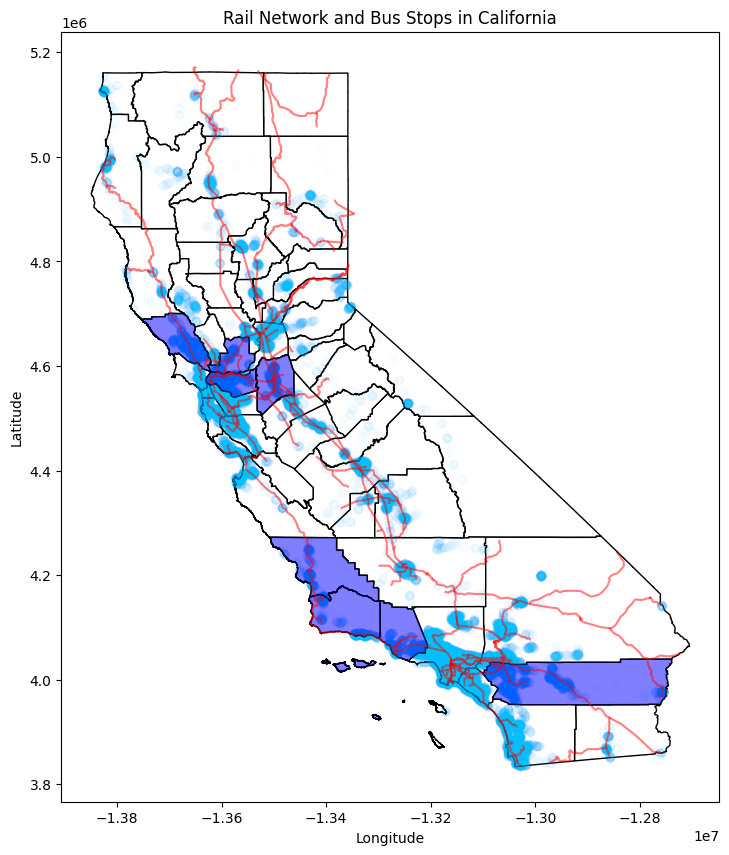

In [146]:
gdf2 = cali_highlight
gdf1 = cali_rail
gdf3 = cali_final
gdf4 = cali_stops

merged_gdf = gpd.sjoin(gdf4, gdf3, how='inner', op='intersects')
# Plot the original GeoDataFrames
ax = gdf3.plot(color='white',edgecolor='black', alpha=1, figsize=(10,10))  # Original GeoDataFrame 1
gdf1.plot(ax=ax, color='red', alpha=0.5)  # Original GeoDataFrame 2
merged_gdf.plot(ax=ax, color='deepskyblue', alpha=0.01)
gdf2.plot(ax=ax, color = 'blue', edgecolor='black', alpha=0.5)  # Original GeoDataFrame 2
#gdf4.plot(ax=ax, color = 'maroon', edgecolor='black', alpha=0.5)

# Customize the plot
plt.title('Rail Network and Bus Stops in California')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

###Top universities in California data source

https://github.com/TZstatsADS/Fall2018-Project2-sec2proj2_grp2/blob/master/data/National%20Universities%20Rankings.csv

### Plotting the universities in California

In [147]:
us_universities = pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/National_Universities_Rankings.csv')
us_universities = pd.DataFrame(us_universities)

In [148]:
cali_universities = us_universities[us_universities['Location'].str[-2:] == 'CA']
cali_universities = cali_universities[['Name','Location','Rank']]
cali_universities

,Name,Location,Rank
5,Stanford University,"Stanford, CA",5
11,California Institute of Technology,"Pasadena, CA",12
21,University of California--Berkeley,"Berkeley, CA",20
22,University of Southern California,"Los Angeles, CA",23
24,University of California--Los Angeles,"Los Angeles, CA",24
37,University of California--Santa Barbara,"Santa Barbara, CA",37
42,University of California--Irvine,"Irvine, CA",39
44,University of California--Davis,"Davis, CA",44
45,University of California--San Diego,"La Jolla, CA",44
49,Pepperdine University,"Malibu, CA",50


In [149]:
from folium.plugins import MarkerCluster
style_function = lambda x: {'fillColor':'red','color':'black'}

m = f.Map(location=geolocator.geocode("California")[1], zoom_start=6)
marker_cluster = MarkerCluster().add_to(m)
# Add the shapefile to the map
f.GeoJson(cali_highlight, style_function=style_function).add_to(m)
#m = f.Map(location=geolocator.geocode("California")[1], zoom_start=6)
for index, row in cali_universities.iterrows():
  f.Marker(geolocator.geocode(row['Name'])[1], popup=row['Name']).add_to(marker_cluster)
m.save('m.html')
m

###Ideal Place to live

From the above inferences we can see that **'Riverside'** county despite of having less crime, good income, good weather and affordable house, it does not have easy acces to public transportaion and top schools in the state. Hence, it is safe to say that we can remove this county from the ideal places. The new set of places is plotted below

<Axes: >

<Axes: >

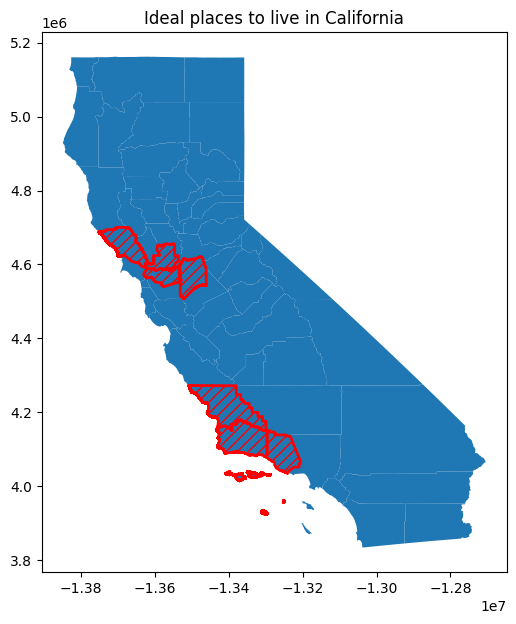

In [179]:
cali_highlight_new=cali_final.query("COUNTY_NAM=='Ventura' | COUNTY_NAM=='Santa Barbara' | COUNTY_NAM=='San Bernito' | COUNTY_NAM=='San Joaquin' | COUNTY_NAM=='Contra Costa' | COUNTY_NAM=='Solano' | COUNTY_NAM=='Sonoma' | COUNTY_NAM=='San Luis Obispo'")
fig, ax = plt.subplots(1, figsize=(6,10))
cali_final.plot(ax=ax)
cali_highlight_new.plot(ax=ax,edgecolor='red',linewidth=2, facecolor="none",alpha=1,hatch='///')
ax.title.set_text("Ideal places to live in California")

### Plotting the heatmap of police stations in California

Police stations data source: https://hub.arcgis.com/datasets/CalEMA::local-law-enforcement-locations/explore

In [180]:
cali_police_stations = pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/Local_Law_Enforcement_Locations_2.csv')
cali_police_stations = pd.DataFrame(cali_police_stations)
cali_police_stations

,X,Y,OBJECTID,ID,NAME,ADDRESS,CITY,STATE,ZIP,ZIP4,...,SUBTYPE1,SUBTYPE2,TRIBAL,NUMPRE,NUMFIXSUB,NUMMOBILE,FTSWORN,FTCIV,PTSWORN,PTCIV
0,-121.753857,36.908623,48,1002375,WATSONVILLE POLICE DEPARTMENT,215 UNION STREET,WATSONVILLE,CA,95076,5009,...,-999,-999,0,0,2,0,64,23,0,0
1,-121.232070,37.799778,49,1001840,MANTECA POLICE DEPARTMENT,1001 WEST CENTER STREET,MANTECA,CA,95337,4302,...,-999,-999,0,0,0,0,76,34,0,0
2,-123.803855,39.432339,50,1001644,FORT BRAGG POLICE DEPARTMENT,250 CYPRESS STREET,FORT BRAGG,CA,95437,5437,...,-999,-999,0,0,0,0,17,6,0,0
3,-117.690929,34.012609,80,1001525,CHINO POLICE DEPARTMENT,13250 CENTRAL AVENUE,CHINO,CA,91710,4127,...,-999,-999,0,0,0,0,96,46,7,12
4,-117.328683,33.225881,81,1001950,OCEANSIDE POLICE DEPARTMENT,3855 MISSION AVENUE,OCEANSIDE,CA,92054,1882,...,-999,-999,0,0,3,0,210,98,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,-117.961162,34.081914,2529,1001454,BALDWIN PARK UNIFIED SCHOOL DISTRICT POLICE,3699 HOLLY AVENUE,BALDWIN PARK,CA,91706,5327,...,1,14,0,0,3,0,9,4,1,5
244,-122.234558,37.780709,2530,1001942,OAKLAND HOUSING AUTHORITY POLICE DEPARTMENT,1180 25TH AVENUE,OAKLAND,CA,94601,1432,...,1,16,0,0,0,1,17,8,0,0
245,-119.639576,36.984588,2531,1001666,TABLE MOUNTAIN TRIBAL POLICE DEPARTMENT,8184 TABLE MOUNTAIN RD,FRIANT,CA,93619,NOT AVAILABLE,...,-999,-999,1,0,0,0,11,9,0,0
246,-122.419306,37.779278,2532,1002172,SAN FRANCISCO SHERIFF'S DEPARTMENT,"1 DR CARLTON B GOODLETT PL, CITY HALL, ROOM 456",SAN FRANCISCO,CA,94102,NOT AVAILABLE,...,-999,-999,0,0,0,0,838,175,0,0


In [181]:
mymap = f.Map(location=geolocator.geocode("California")[1])

# Create a heatmap layer using the latitude and longitude data
heat_data = [[point['Y'], point['X']] for index, point in cali_police_stations.iterrows()]
f.plugins.HeatMap(heat_data).add_to(mymap)

# Save the map to an HTML file
mymap.save('heatmap.html')
mymap

<Axes: >

[]

[]

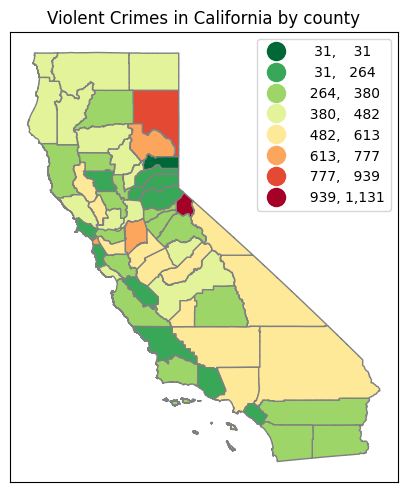

In [182]:
map12 = pd.merge(cali_final,cali_crime, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(5,10))
map2.plot(ax=ax,column='Violent',legend=True,cmap='RdYlGn_r',
          scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})
leg1 = ax.get_legend()
ax.title.set_text("Violent Crimes in California by county")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks

<Axes: >

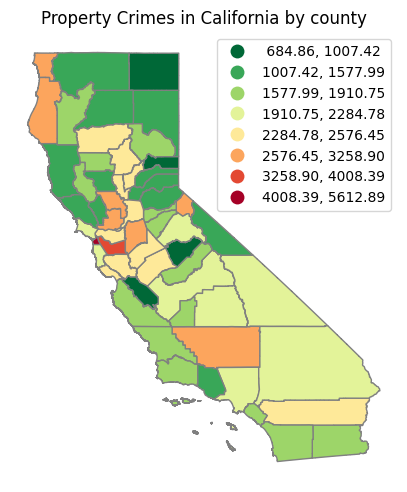

In [183]:
map13 = pd.merge(cali_final,cali_crime, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax) = plt.subplots(1,figsize=(5,10))
map3.plot(ax=ax,column='Property',cmap='RdYlGn_r', scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,legend=True)
leg1 = ax.get_legend()
ax.set_axis_off()
ax.title.set_text("Property Crimes in California by county")

By comparing the crimes in the above 2 maps we can see that there are less number of police stations where more violent crimes happened.

This can be 1 of the reasons for high crime there. This is 1 aspect that can be improved

# **PS4**

In PS3, I had considered police stations for interpreting relation between crime and number of police stations.

Also, in my extended research for looking for the ideal place to live in Califronia, I had considered pparameters such as weather, acces to top schools and access to public transport

In PS4, I will interpret relations by adding new factors like unemployment and poverty. I will interpret relationship between Income, Unemployment, Poverty and Illiteracy.

In my extended research for the ideal place to live, I will check for additional factors like access to healthcare in the counties, tax in each county, and acces to airport services

### Dataset resources

Califonia median income data: https://data.ca.gov/dataset/income-limits-by-county (Used in earlier PS)

California Illiteracy data: https://nces.ed.gov/naal/estimates/stateestimates.aspx (Used in earlier PS)

California Poverty data: https://data.ers.usda.gov/reports.aspx?ID=17826

California Unemployment data: https://data.ers.usda.gov/reports.aspx?ID=17828

California hospital list data: https://data.cms.gov/provider-data/dataset/xubh-q36u

California list of airports data: https://www.downloadexcelfiles.com/us_en/download-excel-file-list-airports-united-states#gsc.tab=0

California tax data: https://www.salestaxhelper.com/our-locations/california/california-sales-tax-rates/

### Importing all datasets

In [184]:
cali_highlight_final=cali_final.query("COUNTY_NAM=='Ventura' | COUNTY_NAM=='Santa Barbara' | COUNTY_NAM=='San Bernito' | COUNTY_NAM=='San Joaquin' | COUNTY_NAM=='Contra Costa' | COUNTY_NAM=='Solano' | COUNTY_NAM=='Sonoma' | COUNTY_NAM=='San Luis Obispo'")


In [185]:
cali_poverty = pd.read_excel('https://github.com/ramannaik1408/GIS/raw/main/PovertyReport.xlsx')
cali_poverty = pd.DataFrame(cali_poverty)
cali_poverty.rename(columns={'Name': 'COUNTY_NAM'}, inplace=True)
cali_poverty

,FIPS*,Unnamed: 1,Unnamed: 2,COUNTY_NAM,Unnamed: 4,RUC Code,Percent,Lower Bound,Upper Bound,Percent.1,Lower Bound.1,Upper Bound.1
0,6000,NaN,NaN,California,NaN,NaN,12.3,12.2,12.4,15.8,15.5,16.1
1,6001,NaN,NaN,Alameda,NaN,1.0,9.4,8.6,10.2,9.9,8.5,11.3
2,6003,NaN,NaN,Alpine,NaN,8.0,15.8,12.1,19.5,27.2,19.3,35.1
3,6005,NaN,NaN,Amador,NaN,6.0,11.1,8.5,13.7,13.5,9.6,17.4
4,6007,NaN,NaN,Butte,NaN,3.0,16.6,14.7,18.5,18.3,14.4,22.2
5,6009,NaN,NaN,Calaveras,NaN,6.0,13.5,11.1,15.9,18.3,13.7,22.9
6,6011,NaN,NaN,Colusa,NaN,6.0,11.4,8.8,14.0,15.6,11.4,19.8
7,6013,NaN,NaN,Contra Costa,NaN,1.0,8.8,8.0,9.6,11.3,9.9,12.7
8,6015,NaN,NaN,Del Norte,NaN,7.0,21.4,17.2,25.6,27.2,20.3,34.1
9,6017,NaN,NaN,El Dorado,NaN,1.0,8.8,7.3,10.3,10.5,8.2,12.8


In [186]:
cali_unemployment = pd.read_excel('https://github.com/ramannaik1408/GIS/raw/main/UnemploymentReport.xlsx')
cali_unemployment = pd.DataFrame(cali_unemployment)
cali_unemployment['Name']=cali_unemployment['Name'].str.replace(' County, CA','')
cali_unemployment.rename(columns={'Name': 'COUNTY_NAM'}, inplace=True)
cali_unemployment

,Unnamed: 0,FIPS,COUNTY_NAM,2014,2015,2016,2017,2018,2019,2020,2021,2022,Median Household Income (2021),Unnamed: 13,% of State Median HH Income
0,NaN,6000.0,California,7.6,6.3,5.5,4.8,4.2,4.1,10.1,7.3,4.2,84831.0,NaN,1.000000
1,NaN,6001.0,Alameda,5.9,4.8,4.3,3.7,3.1,3.0,8.9,6.1,3.3,108971.0,NaN,1.284566
2,NaN,6003.0,Alpine,8.3,7.5,6.5,6.2,4.6,5.2,11.7,8.2,5.4,87570.0,NaN,1.032288
3,NaN,6005.0,Amador,8.4,6.6,6.0,5.0,4.1,3.9,9.4,7.0,4.4,68159.0,NaN,0.803468
4,NaN,6007.0,Butte,8.7,7.2,6.6,5.8,5.1,5.1,9.4,6.9,4.5,62982.0,NaN,0.742441
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56,NaN,6111.0,Ventura,6.7,5.7,5.2,4.5,3.8,3.6,8.7,6.2,3.7,95819.0,NaN,1.129528
57,NaN,6113.0,Yolo,7.6,6.5,5.9,5.1,4.3,4.2,7.8,5.9,4.0,76247.0,NaN,0.898811
58,NaN,6115.0,Yuba,11.3,9.3,8.6,7.5,6.4,6.2,10.7,8.4,5.5,60764.0,NaN,0.716295
59,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [187]:
cali_airports = pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/list_of_airports_in_the_united_states.csv')
cali_airports = pd.DataFrame(cali_airports)
cali_airports = cali_airports[cali_airports['State '] == 'California']
cali_airports

,S.No.,State,City,ICAO,FAA,IATA,Airport,Role,Enplanements
39,40,California,Arcata/Eureka,KACV,ACV,ACV,California Redwood Coast–Humboldt County Airport,P-N,94652.0
40,41,California,Bakersfield,KBFL,BFL,BFL,Meadows Field Airport,P-N,131327.0
41,42,California,Burbank,KBUR,BUR,BUR,Hollywood Burbank Airport,P-M,1942417.0
42,43,California,Fresno,KFAT,FAT,FAT,Fresno Yosemite International Airport,P-S,960594.0
43,44,California,Long Beach,KLGB,LGB,LGB,Long Beach Airport,P-S,1039432.0
44,45,California,Los Angeles,KLAX,LAX,LAX,Los Angeles International Airport,P-L,23663410.0
45,46,California,Monterey,KMRY,MRY,MRY,Monterey Regional Airport,P-N,188658.0
46,47,California,Oakland,KOAK,OAK,OAK,Oakland International Airport,P-M,4011953.0
47,48,California,Ontario,KONT,ONT,ONT,Ontario International Airport,P-M,2201528.0
48,49,California,Orange County,KSNA,SNA,SNA,John Wayne Airport,P-M,3807205.0


In [188]:
cali_sales_tax = pd.read_excel('https://github.com/ramannaik1408/GIS/raw/main/California%20Sales%20Tax.xlsx')
cali_sales_tax = pd.DataFrame(cali_sales_tax)
cali_sales_tax.rename(columns={'County': 'COUNTY_NAM'}, inplace=True)
cali_sales_tax

,COUNTY_NAM,State Rate,County Rate,Total Sales Tax
0,Alameda,7.25,3.00,10.250
1,Alpine,7.25,0.00,7.250
2,Amador,7.25,0.50,7.750
3,Butte,7.25,0.00,7.250
4,Calaveras,7.25,0.00,7.250
5,Colusa,7.25,0.00,7.250
6,Contra Costa,7.25,1.50,8.750
7,Del Norte,7.25,1.25,8.500
8,El Dorado,7.25,0.00,7.250
9,Fresno,7.25,0.73,7.975


In [189]:
cali_hospitals = pd.read_csv('https://github.com/ramannaik1408/GIS/raw/main/hospital-data.csv')
cali_hospitals = pd.DataFrame(cali_hospitals)
cali_hospitals = cali_hospitals[cali_hospitals['State'] == 'CA']
cali_hospitals

,Provider Number,Hospital Name,Address 1,Address 2,Address 3,City,State,ZIP Code,County,Phone Number,Hospital Type,Hospital Ownership,Emergency Services
278,050002,ST ROSE HOSPITAL,27200 CALAROGA AVE,NaN,NaN,HAYWARD,CA,94545,ALAMEDA,5107826200,Acute Care Hospitals,Voluntary non-profit - Church,Yes
279,050006,ST JOSEPH HOSPITAL,2700 DOLBEER ST,NaN,NaN,EUREKA,CA,95501,HUMBOLDT,7074458121,Acute Care Hospitals,Voluntary non-profit - Church,Yes
280,050007,PENINSULA MEDICAL CENTER,1501 TROUSDALE DRIVE,NaN,NaN,BURLINGAME,CA,94010,SAN MATEO,6506965270,Acute Care Hospitals,Voluntary non-profit - Private,Yes
281,050008,CALIFORNIA PACIFIC MEDICAL CTR-DAVIES CAMPUS HOSP,45 CASTRO STREET,NaN,NaN,SAN FRANCISCO,CA,94114,SAN FRANCISCO,4156006000,Acute Care Hospitals,Voluntary non-profit - Other,Yes
282,050009,QUEEN OF THE VALLEY MEDICAL CENTER,1000 TRANCAS ST,NaN,NaN,NAPA,CA,94558,NAPA,7072524411,Acute Care Hospitals,Voluntary non-profit - Church,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...
618,051331,SANTA YNEZ VALLEY COTTAGE HOSPITAL,2050 VIBORG RD,NaN,NaN,SOLVANG,CA,93463,SANTA BARBARA,8056886431,Critical Access Hospitals,Voluntary non-profit - Private,Yes
619,051332,MARK TWAIN ST JOSEPH'S HOSPITAL,768 MOUNTAIN RANCH RD,NaN,NaN,SAN ANDREAS,CA,95249,CALAVERAS,2097542515,Critical Access Hospitals,Voluntary non-profit - Other,Yes
620,053302,CHILDREN'S HOSP OF LOS ANGELES,4650 SUNSET BLVD,NaN,NaN,LOS ANGELES,CA,90027,LOS ANGELES,3236692164,Childrens,Voluntary non-profit - Other,Yes
621,053305,LUCILE SALTER PACKARD CHILDREN'S HSP AT STANFORD,725 WELCH ROAD,NaN,NaN,PALO ALTO,CA,94304,SANTA CLARA,6504978000,Childrens,Voluntary non-profit - Private,Yes


### Income vs Unemployment

In [190]:
cali_income = map1.copy()
cali_income["geometry"] = cali_income["geometry"].centroid

<Axes: >

[]

[]

<Axes: title={'center': 'Income vs Unemployment in California'}>

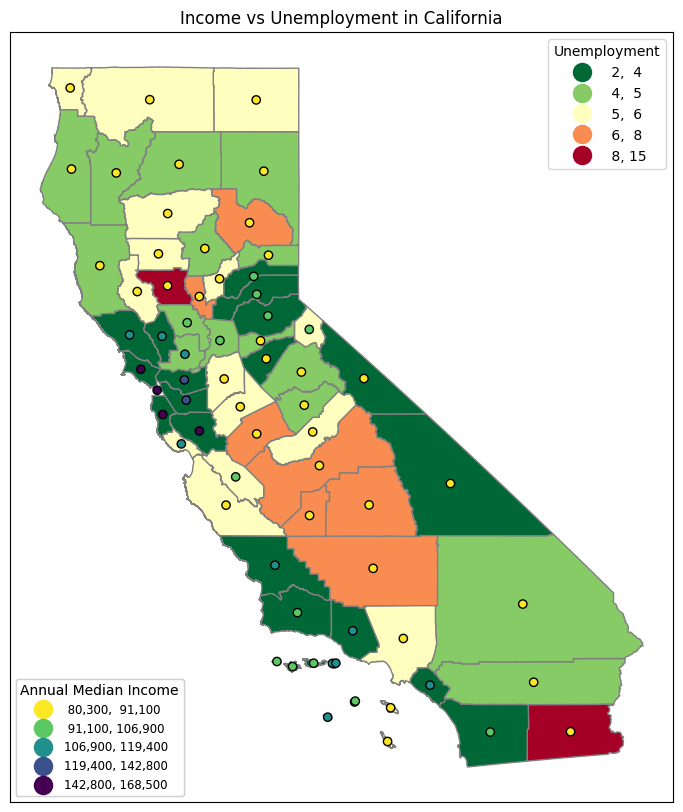

In [191]:
map14= pd.merge(cali_final, cali_unemployment, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(10,10))
map14.plot(ax=ax,column="2022",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Unemployment''')

ax.title.set_text("Income vs Unemployment in California")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
cali_income.plot(ax=ax,column='Annual Median Income',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Annual Median Income''')

ax.add_artist(l2)
ax.add_artist(l1)

### Poverty vs Unemployment

In [192]:
map15= pd.merge(cali_final, cali_unemployment, on='COUNTY_NAM',how='outer',indicator=False)
map15["geometry"] = map15["geometry"].centroid

<Axes: >

[]

[]

<Axes: title={'center': 'Poverty vs Unemployment in California'}>

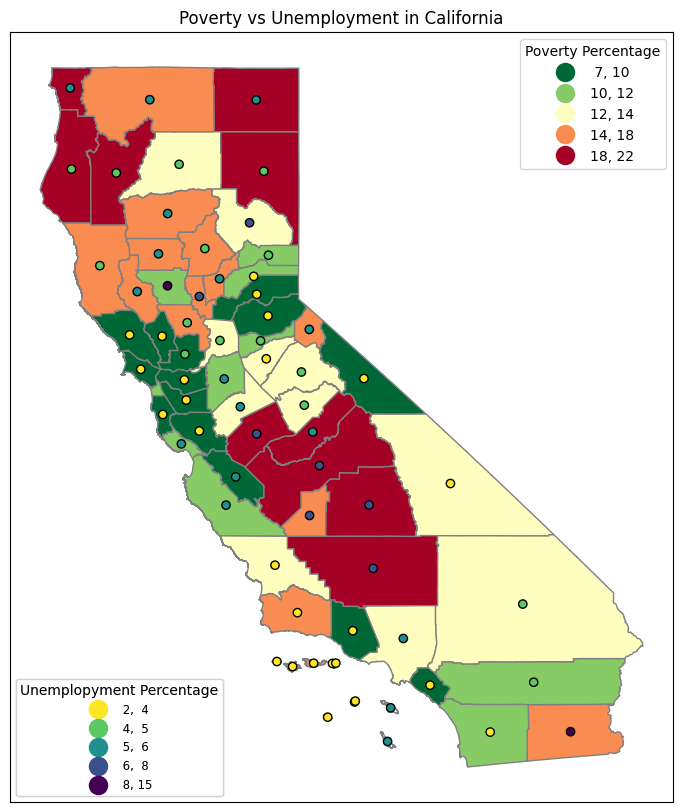

In [193]:
map16= pd.merge(cali_final, cali_poverty, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(10,10))
map16.plot(ax=ax,column="Percent",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Poverty Percentage''')

ax.title.set_text("Poverty vs Unemployment in California")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
map15.plot(ax=ax,column='2022',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Unemplopyment Percentage''')

ax.add_artist(l2)
ax.add_artist(l1)

### Poverty vs Income

<Axes: >

[]

[]

<Axes: title={'center': 'Poverty vs Income in California'}>

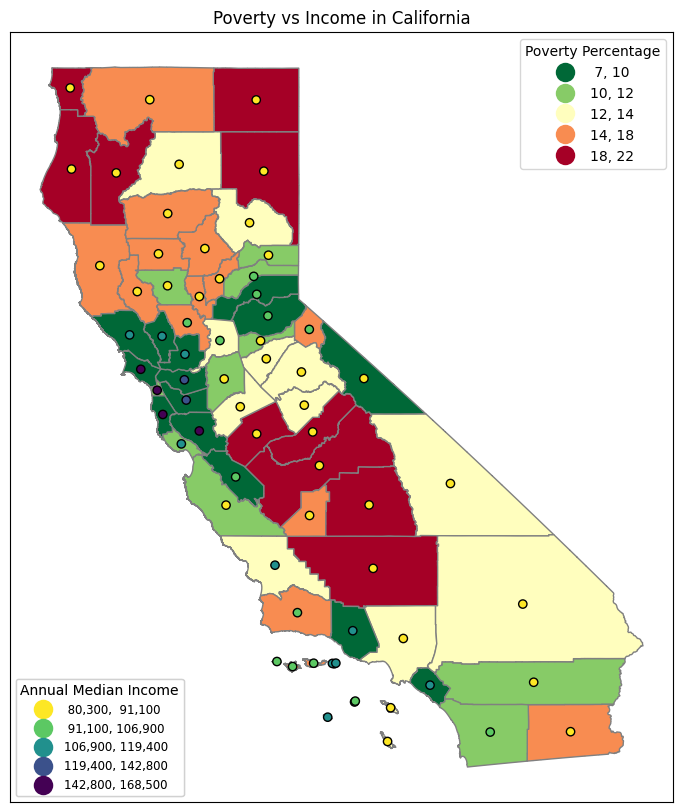

In [194]:
map17= pd.merge(cali_final, cali_poverty, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(10,10))
map17.plot(ax=ax,column="Percent",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Poverty Percentage''')

ax.title.set_text("Poverty vs Income in California")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
cali_income.plot(ax=ax,column='Annual Median Income',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Annual Median Income''')

ax.add_artist(l2)
ax.add_artist(l1)

### Illiteracy vs Income

<Axes: >

[]

[]

<Axes: title={'center': 'Illiteracy vs Income in California'}>

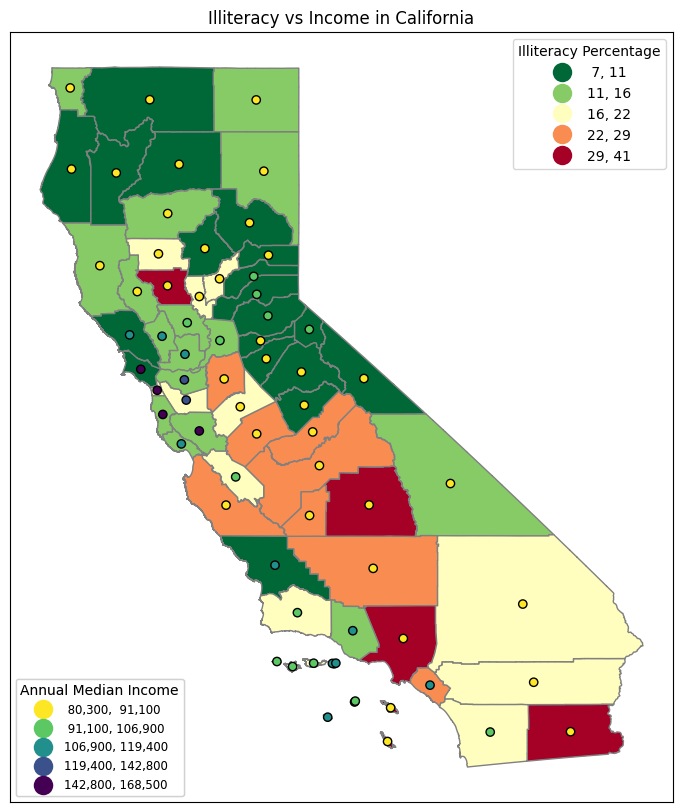

In [195]:
map17= pd.merge(cali_final, cali_literacy, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(10,10))
map17.plot(ax=ax,column="Percent lacking basic prose literacy skills",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Illiteracy Percentage''')

ax.title.set_text("Illiteracy vs Income in California")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
cali_income.plot(ax=ax,column='Annual Median Income',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Annual Median Income''')

ax.add_artist(l2)
ax.add_artist(l1)

### Illiteracy vs Unemployment

In [196]:
unemployment = map14.copy()
unemployment["geometry"] = unemployment["geometry"].centroid

<Axes: >

[]

[]

<Axes: title={'center': 'Illiteracy vs Unemployment in California'}>

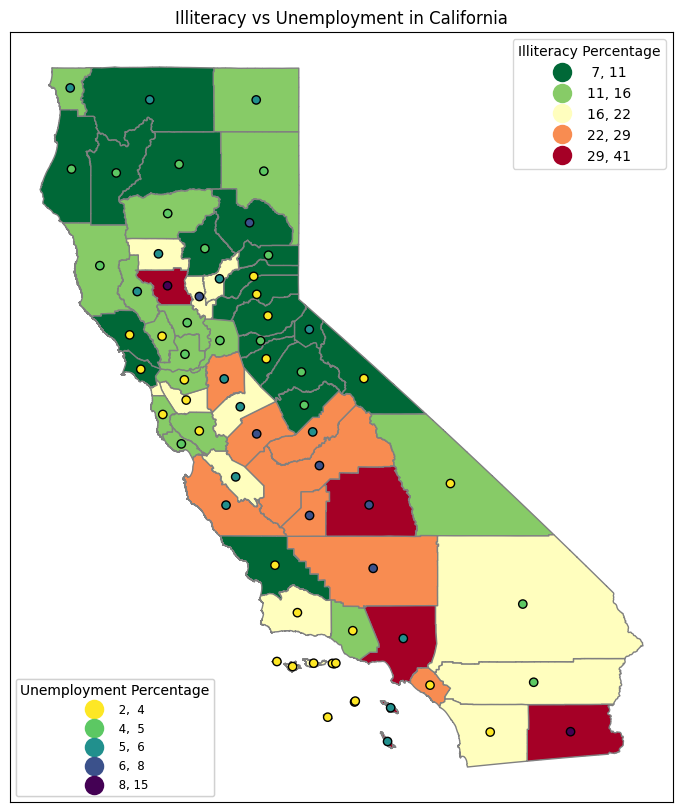

In [197]:
map18= pd.merge(cali_final, cali_literacy, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(10,10))
map17.plot(ax=ax,column="Percent lacking basic prose literacy skills",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Illiteracy Percentage''')

ax.title.set_text("Illiteracy vs Unemployment in California")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
unemployment.plot(ax=ax,column='2022',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Unemployment Percentage''')

ax.add_artist(l2)
ax.add_artist(l1)

In [198]:
import plotly.graph_objects as go

fig = go.Figure()

fig1 = fig.add_trace(go.Scatter(x=cali_literacy['COUNTY_NAM'], y=cali_literacy['Percent lacking basic prose literacy skills'], mode='lines', name='Illiteracy Rate', line=dict(color='#53D1BA')))
fig1 = fig.add_trace(go.Scatter(x=cali_unemployment['COUNTY_NAM'], y=cali_unemployment['2022'], mode='lines', name='Unemployment Rate', line=dict(color='#D11E5D')))

fig2 = fig1.update_layout(
    title='Illiteracy vs Unemployment',
    xaxis=dict(title='Counties in California'),
    yaxis=dict(title='Illiteracy Rate'),
    yaxis2=dict(title='Unemplopyment Rate', overlaying='y', side='right'),
    legend=dict(x=0.1, y=1.15, orientation='h'),
    template='plotly_dark')

fig2.show()

### Illiteracy vs Poverty

In [199]:
poverty = map16.copy()
poverty["geometry"] = poverty["geometry"].centroid

<Axes: >

[]

[]

<Axes: title={'center': 'Illiteracy vs Poverty in California'}>

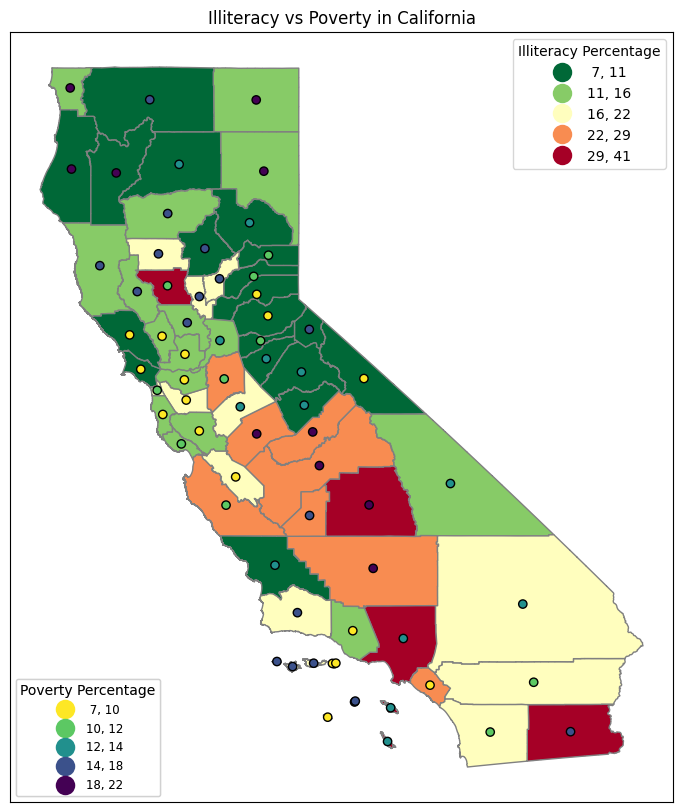

In [200]:
map19= pd.merge(cali_final, cali_literacy, on='COUNTY_NAM',how='outer',indicator=False)
fig, ax = plt.subplots(1, figsize=(10,10))
map17.plot(ax=ax,column="Percent lacking basic prose literacy skills",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''Illiteracy Percentage''')

ax.title.set_text("Illiteracy vs Poverty in California")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills xticks
poverty.plot(ax=ax,column='Percent',legend=True,cmap='viridis_r',scheme='natural_breaks',k=5,
         edgecolor='black',linewidth=1,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'lower left','title_fontsize':'medium','fontsize':'small','markerscale':1.4})

l2 = ax.get_legend()
l2.set_title('''Poverty Percentage''')

ax.add_artist(l2)
ax.add_artist(l1)

## Ideal place to live

###Airport

In [201]:
from folium.plugins import MarkerCluster
style_function = lambda x: {'fillColor':'red','color':'black'}

m = f.Map(location=geolocator.geocode("California")[1], zoom_start=6)
marker_cluster = MarkerCluster().add_to(m)
# Add the shapefile to the map
f.GeoJson(cali_highlight_final, style_function=style_function).add_to(m)
#m = f.Map(location=geolocator.geocode("California")[1], zoom_start=6)
for index, row in cali_airports.iterrows():
  f.Marker(geolocator.geocode(row['Airport'])[1], popup=row['Airport']).add_to(marker_cluster)
m.save('m.html')
m

From the above folium map, we can see that all the shortlisted counties for the ideal places to live have accesible airports or have airports in their neighbouring counties so that they are easily accessiblr, hence all the counties are still ideal for living

### Hospitals in California

#### Number of hospitals in each county

In [208]:
cali_hospitals_count = cali_hospitals.groupby('County').size().reset_index(name='No of Hospitals')
cali_hospitals_count.rename(columns={'County': 'COUNTY_NAM'}, inplace=True)
cali_hospitals_count['COUNTY_NAM'] = cali_hospitals_count['COUNTY_NAM'].apply(lambda x: x.title())
cali_hospitals_count = pd.DataFrame(cali_hospitals_count)
cali_hospitals_count

,COUNTY_NAM,No of Hospitals
0,Alameda,10
1,Amador,1
2,Butte,4
3,Calaveras,1
4,Colusa,1
5,Contra Costa,8
6,Del Norte,1
7,El Dorado,2
8,Fresno,8
9,Glenn,1


<Axes: >

[]

[]

<Axes: title={'center': 'Number of Hospitals in each county'}>

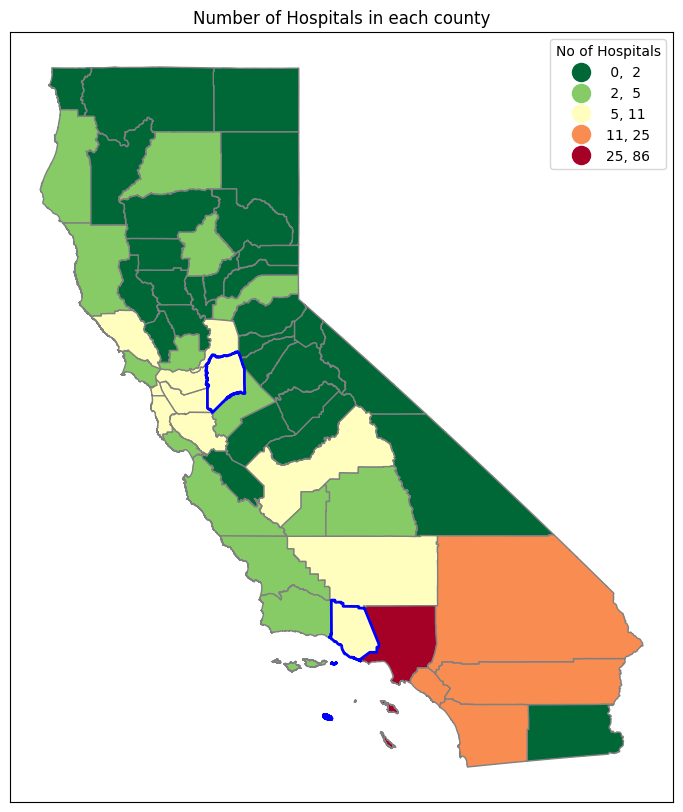

In [209]:
map21= pd.merge(cali, cali_hospitals_count, on='COUNTY_NAM',how='left',indicator=False)
map21['No of Hospitals'] = map21['No of Hospitals'].fillna(0)# Filling value as 0, if a county does not have a hospital
fig, ax = plt.subplots(1, figsize=(10,10))
map21.plot(ax=ax,column="No of Hospitals",legend=True,cmap='RdYlGn_r',scheme='natural_breaks',k=5, edgecolor='grey',linewidth=1,
          legend_kwds= {"fmt": "{:,.0f}",'loc':'upper right','markerscale':1.4})

l1 = ax.get_legend()
l1.set_title('''No of Hospitals''')

ax.title.set_text("Number of Hospitals in each county")
ax.set_xticks([]) #kills xticks
ax.set_yticks([]) #kills yticks

cali_highlight_final.plot(ax=ax,edgecolor='blue',linewidth=2, facecolor="none",alpha=1)

From the above map, we can see that 3 of the counties shortlisted earlier(Santa Barbara, San Luis Obispo and Solano) have low number(2-5) of accessible hospitals.

Hence, it is safe to say that we can remove them from ideal places to live as access to healthcare facilities is really important

In [210]:
cali_highlight_final=cali_final.query("COUNTY_NAM=='Ventura' | COUNTY_NAM=='San Joaquin' | COUNTY_NAM=='Contra Costa' | COUNTY_NAM=='Sonoma' ")

### Sales tax in each county

In [211]:
cali_sales_tax = pd.read_excel('https://github.com/ramannaik1408/GIS/raw/main/California%20Sales%20Tax.xlsx')
cali_sales_tax = pd.DataFrame(cali_sales_tax)
cali_sales_tax.rename(columns={'County': 'COUNTY_NAM'}, inplace=True)
cali_sales_tax

,COUNTY_NAM,State Rate,County Rate,Total Sales Tax
0,Alameda,7.25,3.00,10.250
1,Alpine,7.25,0.00,7.250
2,Amador,7.25,0.50,7.750
3,Butte,7.25,0.00,7.250
4,Calaveras,7.25,0.00,7.250
5,Colusa,7.25,0.00,7.250
6,Contra Costa,7.25,1.50,8.750
7,Del Norte,7.25,1.25,8.500
8,El Dorado,7.25,0.00,7.250
9,Fresno,7.25,0.73,7.975


<Axes: >

<Axes: title={'center': 'Sales Tax in California by county'}>

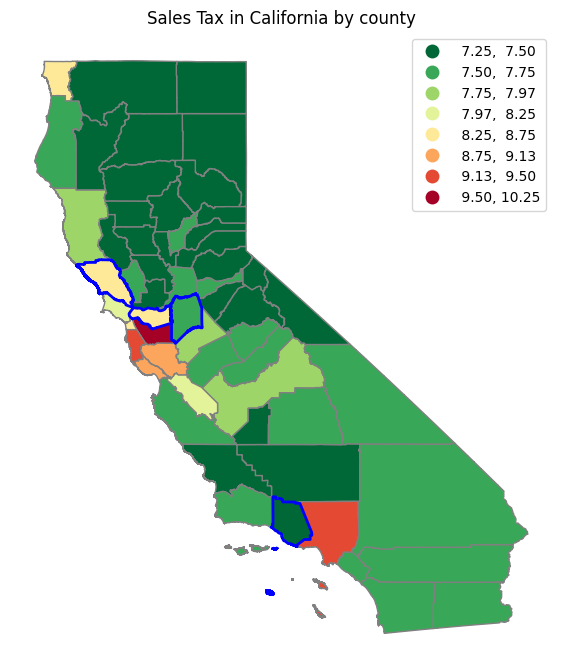

In [212]:
map20 = pd.merge(cali_final,cali_sales_tax, on='COUNTY_NAM',how='outer',indicator=False)
fig, (ax) = plt.subplots(1,figsize=(7,10))
map20.plot(ax=ax,column='Total Sales Tax',cmap='RdYlGn_r', scheme='natural_breaks',k=8, edgecolor='grey',linewidth=1,legend=True)
leg1 = ax.get_legend()
ax.set_axis_off()
ax.title.set_text("Sales Tax in California by county")

cali_highlight_final.plot(ax=ax,edgecolor='blue',linewidth=2, facecolor="none",alpha=1)

From the above map we can see that 2 of the further shortlisted counties(Sonoma and Contra Costa) have comparitively higher sales tax. Hence we can remove them from the ideal places to live.

I would have loved to compare income taxes for this research as well, but it turns out whole of California pays the same income tax, except for San Francisco which pays slightly higher, but it i outside of our shortlisted counties as it has high housing rates as seen in previous PS

So we are left with 2 counties which are ideal.

For people who are looking to settle in California, the best paces to live would be counties of Ventura and San Jaoquin, that are close to Los Angeles and San Francisco Bay Area which are final in our ideal places to live, which is highlighted in the map below

<Axes: >

<Axes: >

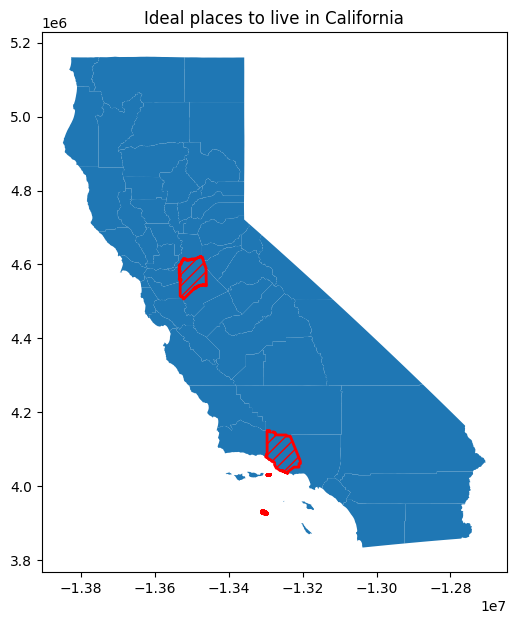

In [214]:
cali_highlight_final=cali_final.query("COUNTY_NAM=='Ventura' | COUNTY_NAM=='San Joaquin'")
fig, ax = plt.subplots(1, figsize=(6,10))
cali_final.plot(ax=ax)
cali_highlight_final.plot(ax=ax,edgecolor='red',linewidth=2, facecolor="none",alpha=1,hatch='///')
ax.title.set_text("Ideal places to live in California")